Define useful boilerplate functions

In [ ]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

torch.set_grad_enabled(False);

2.6.0+cu124 True


In [ ]:
from PIL import Image
import matplotlib.pyplot as plt


In [ ]:
# COCO classes
CLASSES = [
    'N/A', 'person', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A', 'N/A', 'N/A', 'N/A', 'N/A', 'N/A',
    'N/A'
]

# colors for visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from PIL import Image
import requests

#real one ->
im = '/content/drive/MyDrive/peddet_2_1.jpg'


im = Image.open('/content/drive/MyDrive/peddet_2_1.jpg').convert("RGB")

#dummy one ->
im_d = '/content/drive/MyDrive/peddet_2_1.jpg'


im_d = Image.open('/content/drive/MyDrive/peddet_2_1.jpg').convert("RGB")

#url = 'http://images.cocodataset.org/train2017/000000310645.jpg'
#im = Image.open(requests.get(url, stream=True).raw)


In [ ]:
print('Type of "im" =  ',type(im))
print("Mode (tells us how many channels in the stored image = ",im.mode, "\n")

print("Size of the image = ", im.size, "\n")




Type of "im" =   <class 'PIL.Image.Image'> 
it means that the variable (in this case, - im) is an object of the Image class, which lives inside the PIL.Image module 

Mode (tells us how many channels in the stored image =  RGB 

Size of the image =  (1920, 1080) 



In [ ]:
import torchvision.transforms as T

# standard PyTorch mean-std input image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [ ]:
def filter_bboxes_from_outputs(outputs,
                               threshold=0.7):

  # keep only predictions with confidence above threshold
  probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > threshold

  probas_to_keep = probas[keep]

  # convert boxes from [0; 1] to image scales
  bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)

  return probas_to_keep, bboxes_scaled

In [ ]:


def plot_results(pil_img, prob=None, boxes=None):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if prob is not None and boxes is not None:
      for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
          ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=c, linewidth=3))
          cl = p.argmax()
          text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
          ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

Load an image for a demo

In [ ]:
model = torch.hub.load('facebookresearch/detr', 'detr_resnet50', pretrained=True)
model.eval();

Downloading: "https://github.com/facebookresearch/detr/zipball/main" to /root/.cache/torch/hub/main.zip
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 118MB/s]
Downloading: "https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth" to /root/.cache

In [ ]:
# mean-std normalize the input image (batch-size: 1)
img = transform(im).unsqueeze(0)




In [ ]:
print ("The image is passed to the transofrm function- uses 'compose' -  takes a list of transformations and returns a callable object that applies them in sequence to an image \n")
print("But, step by step operations for reference : \n")


The image is passed to the transofrm function- uses 'compose' -  takes a list of transformations and returns a callable object that applies them in sequence to an image 

But, step by step operations for reference : 



In [ ]:
#from here

First, resizing:


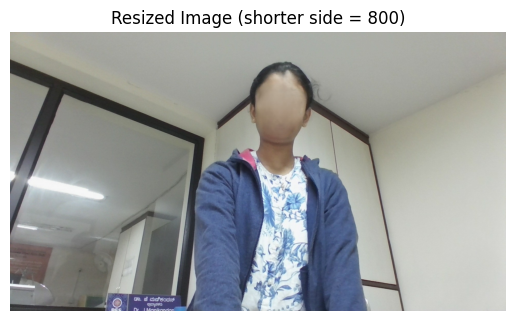

Size of the image =  (1422, 800) 

<class 'PIL.Image.Image'>


In [ ]:
print("First, resizing:")
im_d = T.Resize(800)(im_d)
# Display the resized image
plt.imshow(im_d)
plt.title("Resized Image (shorter side = 800)")
plt.axis('off')
plt.show()
print("Size of the image = ", im_d.size, "\n")
print(type(im_d))

In [ ]:
#raw pixel values after resizing
import numpy as np

# Convert the PIL image to a NumPy array
pixel_values = np.array(im_d)

# Print the raw pixel values
print("Pixel values:\n", pixel_values)
print("Shape of pixel array:", pixel_values.shape)
print(pixel_values.min(), pixel_values.max())


print("NOT USED IN THIS FORM ANYWHERE IN CODE - JUST TO VISUALIZE THE PIXEL VALUES - SO IGNORE THE PLACEMENT OF DIMENSIONS")


Pixel values:
 [[[163 164 150]
  [166 166 152]
  [170 168 155]
  ...
  [167 170 153]
  [166 169 154]
  [165 169 155]]

 [[164 166 150]
  [166 168 151]
  [168 169 154]
  ...
  [167 169 155]
  [167 169 156]
  [167 170 158]]

 [[164 167 148]
  [166 169 150]
  [167 170 151]
  ...
  [167 169 158]
  [166 168 158]
  [165 168 158]]

 ...

 [[ 58  59  63]
  [ 58  59  62]
  [ 58  59  61]
  ...
  [209 209 209]
  [208 208 208]
  [207 207 207]]

 [[ 58  59  63]
  [ 59  60  62]
  [ 59  60  62]
  ...
  [209 209 209]
  [208 208 208]
  [208 208 208]]

 [[ 57  58  62]
  [ 58  59  62]
  [ 59  60  62]
  ...
  [208 208 208]
  [209 209 209]
  [210 210 210]]]
Shape of pixel array: (800, 1422, 3)
10 255
NOT USED IN THIS FORM ANYWHERE IN CODE - JUST TO VISUALIZE THE PIXEL VALUES - SO IGNORE THE PLACEMENT OF DIMENSIONS


In [ ]:
print("Converts to tensor: ")
print(type(im_d))
to_tensor = T.ToTensor()
im_d = to_tensor(im_d)

print("After ToTensor:", im_d.shape)
print(im_d)  # this will print the raw pixel values in [0, 1]

print(type(im_d))        # <class 'torch.Tensor'>
print(im_d.shape)        # torch.Size([3, height, width])
print(im_d.dtype)        # torch.float32
print(im_d.min(), im_d.max())


Converts to tensor: 
<class 'PIL.Image.Image'>
After ToTensor: torch.Size([3, 800, 1422])
tensor([[[0.6392, 0.6510, 0.6667,  ..., 0.6549, 0.6510, 0.6471],
         [0.6431, 0.6510, 0.6588,  ..., 0.6549, 0.6549, 0.6549],
         [0.6431, 0.6510, 0.6549,  ..., 0.6549, 0.6510, 0.6471],
         ...,
         [0.2275, 0.2275, 0.2275,  ..., 0.8196, 0.8157, 0.8118],
         [0.2275, 0.2314, 0.2314,  ..., 0.8196, 0.8157, 0.8157],
         [0.2235, 0.2275, 0.2314,  ..., 0.8157, 0.8196, 0.8235]],

        [[0.6431, 0.6510, 0.6588,  ..., 0.6667, 0.6627, 0.6627],
         [0.6510, 0.6588, 0.6627,  ..., 0.6627, 0.6627, 0.6667],
         [0.6549, 0.6627, 0.6667,  ..., 0.6627, 0.6588, 0.6588],
         ...,
         [0.2314, 0.2314, 0.2314,  ..., 0.8196, 0.8157, 0.8118],
         [0.2314, 0.2353, 0.2353,  ..., 0.8196, 0.8157, 0.8157],
         [0.2275, 0.2314, 0.2353,  ..., 0.8157, 0.8196, 0.8235]],

        [[0.5882, 0.5961, 0.6078,  ..., 0.6000, 0.6039, 0.6078],
         [0.5882, 0.5922, 0.6039,

In [ ]:
print("Normalise")
normalize = T.Normalize([0.485, 0.456, 0.406], #mean for R, G,B
                        [0.229, 0.224, 0.225]) #standard deviation for RGB
im_d = normalize(im_d)
print("After Normalize:")
print(im_d)  # normalized tensor values - done element wise acorss the full (3, H, W) tensor


Normalise
After Normalize:
tensor([[[ 0.6734,  0.7248,  0.7933,  ...,  0.7419,  0.7248,  0.7077],
         [ 0.6906,  0.7248,  0.7591,  ...,  0.7419,  0.7419,  0.7419],
         [ 0.6906,  0.7248,  0.7419,  ...,  0.7419,  0.7248,  0.7077],
         ...,
         [-1.1247, -1.1247, -1.1247,  ...,  1.4612,  1.4440,  1.4269],
         [-1.1247, -1.1075, -1.1075,  ...,  1.4612,  1.4440,  1.4440],
         [-1.1418, -1.1247, -1.1075,  ...,  1.4440,  1.4612,  1.4783]],

        [[ 0.8354,  0.8704,  0.9055,  ...,  0.9405,  0.9230,  0.9230],
         [ 0.8704,  0.9055,  0.9230,  ...,  0.9230,  0.9230,  0.9405],
         [ 0.8880,  0.9230,  0.9405,  ...,  0.9230,  0.9055,  0.9055],
         ...,
         [-1.0028, -1.0028, -1.0028,  ...,  1.6232,  1.6057,  1.5882],
         [-1.0028, -0.9853, -0.9853,  ...,  1.6232,  1.6057,  1.6057],
         [-1.0203, -1.0028, -0.9853,  ...,  1.6057,  1.6232,  1.6408]],

        [[ 0.8099,  0.8448,  0.8971,  ...,  0.8622,  0.8797,  0.8971],
         [ 0.8099,

In [ ]:
print("After Normalisation:", im_d.shape)

After Normalisation: torch.Size([3, 800, 1422])


In [ ]:
# need to "unsqueeze" -change the dimensions from [3,H,W] -> [1,3,H,W] - (batch_size, channels, height, width)
im_d = im_d.unsqueeze(0)
print ("shape=", im_d.shape, "\n")
print(im_d)

shape= torch.Size([1, 3, 800, 1422]) 

tensor([[[[ 0.6734,  0.7248,  0.7933,  ...,  0.7419,  0.7248,  0.7077],
          [ 0.6906,  0.7248,  0.7591,  ...,  0.7419,  0.7419,  0.7419],
          [ 0.6906,  0.7248,  0.7419,  ...,  0.7419,  0.7248,  0.7077],
          ...,
          [-1.1247, -1.1247, -1.1247,  ...,  1.4612,  1.4440,  1.4269],
          [-1.1247, -1.1075, -1.1075,  ...,  1.4612,  1.4440,  1.4440],
          [-1.1418, -1.1247, -1.1075,  ...,  1.4440,  1.4612,  1.4783]],

         [[ 0.8354,  0.8704,  0.9055,  ...,  0.9405,  0.9230,  0.9230],
          [ 0.8704,  0.9055,  0.9230,  ...,  0.9230,  0.9230,  0.9405],
          [ 0.8880,  0.9230,  0.9405,  ...,  0.9230,  0.9055,  0.9055],
          ...,
          [-1.0028, -1.0028, -1.0028,  ...,  1.6232,  1.6057,  1.5882],
          [-1.0028, -0.9853, -0.9853,  ...,  1.6232,  1.6057,  1.6057],
          [-1.0203, -1.0028, -0.9853,  ...,  1.6057,  1.6232,  1.6408]],

         [[ 0.8099,  0.8448,  0.8971,  ...,  0.8622,  0.8797,  

In [ ]:

# propagate through the model
outputs = model(img)

In [ ]:


# Store hooks
hooks = []

# Define a hook function
def hook_fn(name):
    def hook(module, input, output):
        print(f"\nLayer: {name}")
        if isinstance(output, (tuple, list)):
            for i, out in enumerate(output):
                print(f" Output[{i}]: {out.shape}")
        else:
            print(f" Output: {output.shape}")
    return hook

# Register hooks to all submodules
for name, module in model.named_modules():
    if len(list(module.children())) == 0:  # Only leaf modules
        hooks.append(module.register_forward_hook(hook_fn(name)))

# Run inference
with torch.no_grad():
    outputs = model(img)

# Remove hooks
for hook in hooks:
    hook.remove()




Layer: backbone.0.body.conv1
 Output: torch.Size([1, 64, 400, 711])

Layer: backbone.0.body.bn1
 Output: torch.Size([1, 64, 400, 711])

Layer: backbone.0.body.relu
 Output: torch.Size([1, 64, 400, 711])

Layer: backbone.0.body.maxpool
 Output: torch.Size([1, 64, 200, 356])

Layer: backbone.0.body.layer1.0.conv1
 Output: torch.Size([1, 64, 200, 356])

Layer: backbone.0.body.layer1.0.bn1
 Output: torch.Size([1, 64, 200, 356])

Layer: backbone.0.body.layer1.0.relu
 Output: torch.Size([1, 64, 200, 356])

Layer: backbone.0.body.layer1.0.conv2
 Output: torch.Size([1, 64, 200, 356])

Layer: backbone.0.body.layer1.0.bn2
 Output: torch.Size([1, 64, 200, 356])

Layer: backbone.0.body.layer1.0.relu
 Output: torch.Size([1, 64, 200, 356])

Layer: backbone.0.body.layer1.0.conv3
 Output: torch.Size([1, 256, 200, 356])

Layer: backbone.0.body.layer1.0.bn3
 Output: torch.Size([1, 256, 200, 356])

Layer: backbone.0.body.layer1.0.downsample.0
 Output: torch.Size([1, 256, 200, 356])

Layer: backbone.0.bo

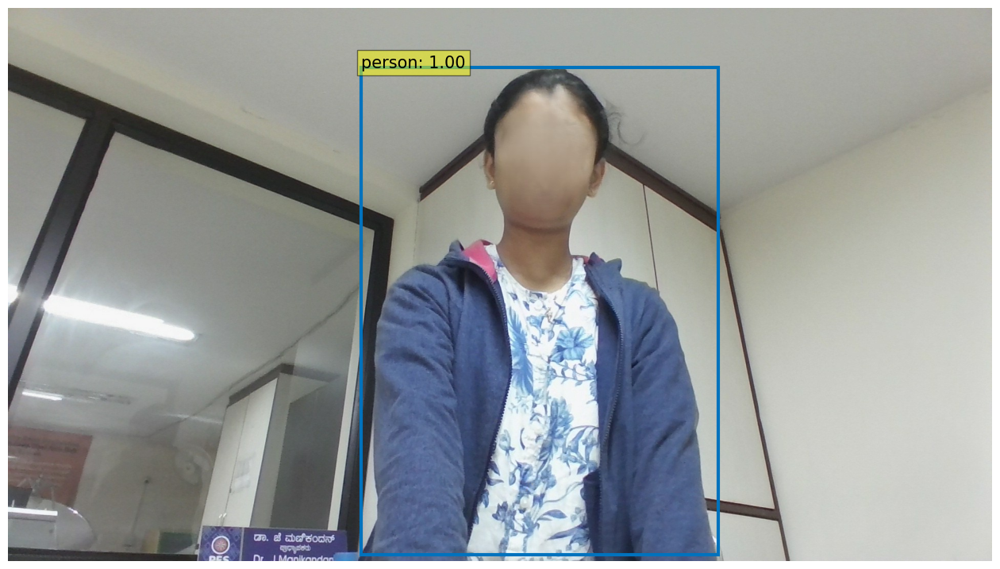

In [ ]:
for threshold in [0.9]:

  probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(outputs,
                                                            threshold=threshold)

  plot_results(im, probas_to_keep, bboxes_scaled)

In [ ]:
from PIL import Image
import requests
activations = {}

def hook_fn(name):
    def hook(module, input, output):
        activations[name] = output
    return hook

# Attach hooks to layers inside the ResNet backbone (which is model.backbone[0])
for name, module in model.backbone[0].named_modules():
    if isinstance(module, (torch.nn.Conv2d, torch.nn.ReLU, torch.nn.BatchNorm2d)):
       module.register_forward_hook(hook_fn(name))


In [ ]:
with torch.no_grad():
    outputs = model(im_d)

In [ ]:
for name, act in activations.items():
    print(f"{name:<40} --> shape: {list(act.shape)}")



body.conv1                               --> shape: [1, 64, 400, 711]
body.relu                                --> shape: [1, 64, 400, 711]
body.layer1.0.conv1                      --> shape: [1, 64, 200, 356]
body.layer1.0.relu                       --> shape: [1, 256, 200, 356]
body.layer1.0.conv2                      --> shape: [1, 64, 200, 356]
body.layer1.0.conv3                      --> shape: [1, 256, 200, 356]
body.layer1.0.downsample.0               --> shape: [1, 256, 200, 356]
body.layer1.1.conv1                      --> shape: [1, 64, 200, 356]
body.layer1.1.relu                       --> shape: [1, 256, 200, 356]
body.layer1.1.conv2                      --> shape: [1, 64, 200, 356]
body.layer1.1.conv3                      --> shape: [1, 256, 200, 356]
body.layer1.2.conv1                      --> shape: [1, 64, 200, 356]
body.layer1.2.relu                       --> shape: [1, 256, 200, 356]
body.layer1.2.conv2                      --> shape: [1, 64, 200, 356]
body.layer1.2.

In [ ]:
import matplotlib.pyplot as plt
import torch

def visualize_all_layers(activations, max_channels=4):
    """
    Visualizes up to `max_channels` feature maps for each layer in `activations`.

    Arguments:
        activations (dict): Dictionary of {layer_name: activation tensor}
        max_channels (int): How many channels to visualize per layer
    """
    for layer_name, tensor in activations.items():
        # Remove batch dimension
        feature_map = tensor[0]  # shape: [C, H, W]

        # Skip if shape is too small or not 3D
        if feature_map.ndim != 3:
            continue

        # Determine how many channels to show
        num_channels = min(max_channels, feature_map.shape[0])

        # Plot
        fig, axs = plt.subplots(1, num_channels, figsize=(num_channels * 4, 4))
        fig.suptitle(layer_name, fontsize=14)

        for i in range(num_channels):
            ax = axs[i] if num_channels > 1 else axs
            ax.imshow(feature_map[i].cpu(), cmap='viridis')
            ax.set_title(f"Channel {i}")
            ax.axis('off')

        plt.tight_layout()
        plt.show()


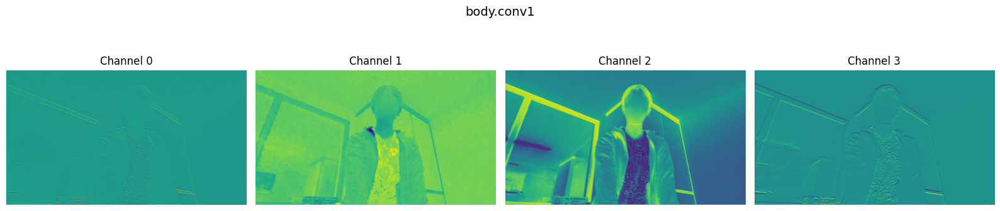

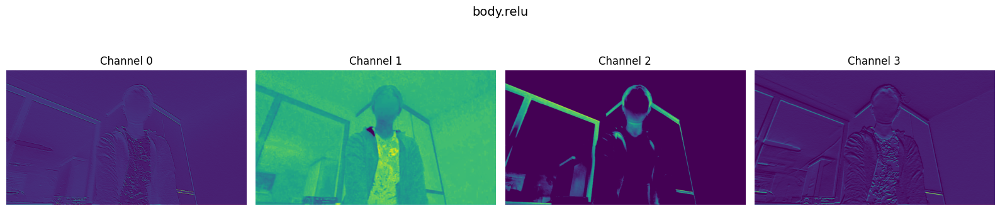

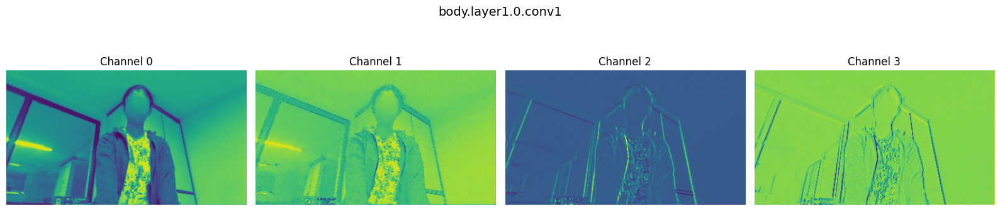

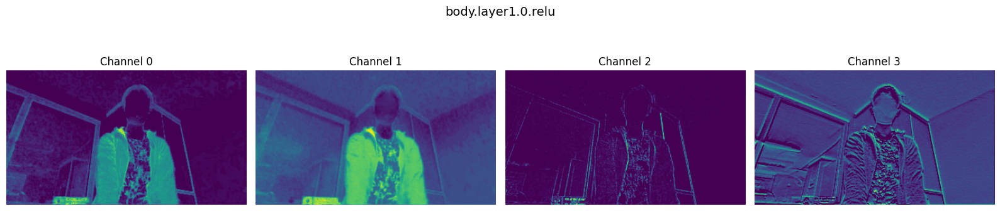

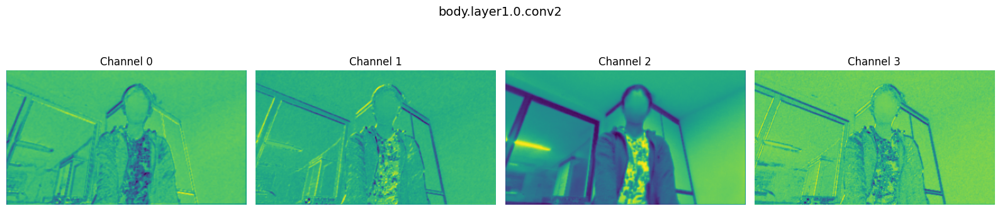

...

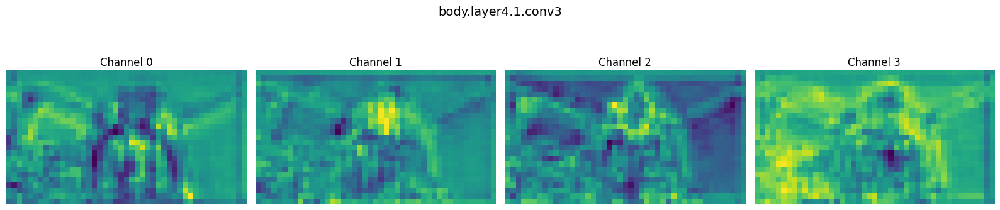

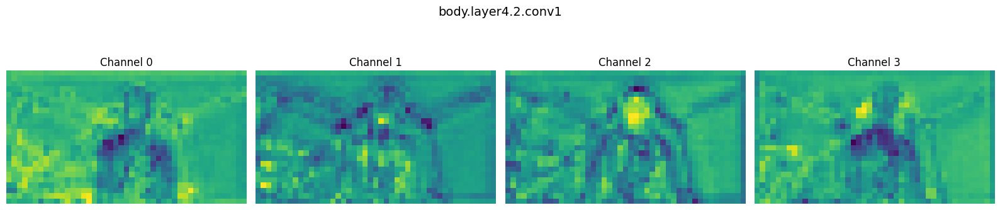

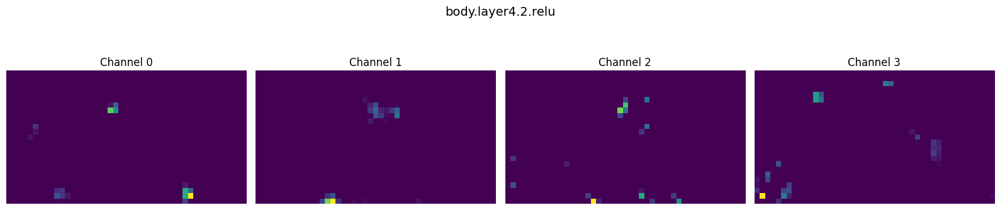

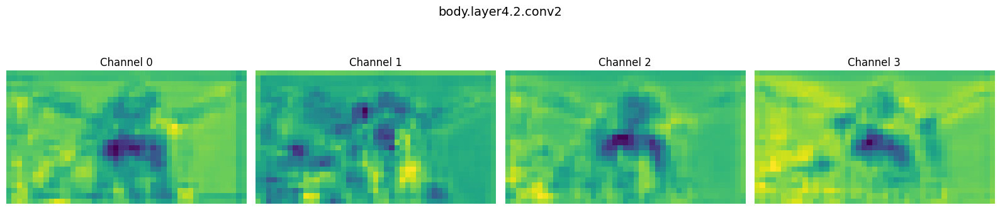

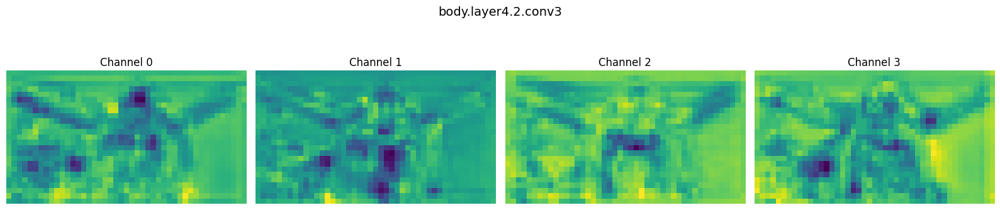

In [ ]:
visualize_all_layers(activations, max_channels=4)


In [ ]:
import torchvision.models as models
model_d = models.resnet50(weights='DEFAULT')

print(model_d.conv1)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 159MB/s]


Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)


In [ ]:

print(model_d.layer1[0].conv1)


Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
print(model.backbone[0].body.layer2[0].conv1)


Conv2d(256, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
